# Audio File Modeling

In [1]:
import spotipy
from spotipy.oauth2 import SpotifyOAuth,SpotifyClientCredentials

import os
import json
import pickle

import numpy as np
from numpy.linalg import norm
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm
from time import sleep

from IPython.display import Audio
import librosa.display
import librosa as lr

from numba import cuda, jit, prange, vectorize, guvectorize
import pycuda.gpuarray as gpuarray
import pycuda.driver as cuda
import pycuda.autoinit

from fastdtw import fastdtw
from linmdtw import linmdtw, dtwgpu
from scipy.spatial.distance import euclidean

import tensorflow as tf
import tensorflow_io as tfio
from tensorflow.keras.losses import cosine_similarity

gpus = tf.config.experimental.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(gpus[0], True)

In [2]:
# load in user json
with open('/media/jesse/Number3/json/Jesse.p.tao.json') as f:
  data = json.load(f)
user_json = pd.DataFrame(data['items'])
user_json.head()

,track,played_at,context
0,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:45.999Z,None
1,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:26.252Z,None
2,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T05:18:06.671Z,{'external_urls': {'spotify': 'https://open.sp...
3,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T01:58:55.395Z,None
4,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T01:45:07.511Z,None


In [3]:
# add columns
track_url = []
track_id = []
track_name = []
for i in range(len(user_json)):
    track_url.append(user_json.iloc[i]['track']['href'])
    track_id.append(user_json.iloc[i]['track']['id'])
    track_name.append(user_json.iloc[i]['track']['name'])
user_json['track_url'] = track_url
user_json['id'] = track_id
user_json['name'] = track_name
user_json.head()

,track,played_at,context,track_url,id,name
0,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:45.999Z,None,https://api.spotify.com/v1/tracks/22LRgvP6LBtm...,22LRgvP6LBtmN5SqGrK3O7,Drown
1,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:26.252Z,None,https://api.spotify.com/v1/tracks/7HAkrW8JUYoV...,7HAkrW8JUYoVR9dXwb6Uku,ホタルノヒカリ
2,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T05:18:06.671Z,{'external_urls': {'spotify': 'https://open.sp...,https://api.spotify.com/v1/tracks/3wWUkfEmfO6q...,3wWUkfEmfO6qvT1iIrrusD,Too Good to Be True
3,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T01:58:55.395Z,None,https://api.spotify.com/v1/tracks/7HAkrW8JUYoV...,7HAkrW8JUYoVR9dXwb6Uku,ホタルノヒカリ
4,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T01:45:07.511Z,None,https://api.spotify.com/v1/tracks/15TaZdhznRBa...,15TaZdhznRBaKzyHLHA9ad,unravel (acoustic version) - Acoustic Version


In [4]:
user_json['track_url'].replace({'api':'open', 'v1/':'', 'tracks':'track'}, inplace = True, regex = True)
user_json.head()

,track,played_at,context,track_url,id,name
0,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:45.999Z,None,https://open.spotify.com/track/22LRgvP6LBtmN5S...,22LRgvP6LBtmN5SqGrK3O7,Drown
1,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T05:19:26.252Z,None,https://open.spotify.com/track/7HAkrW8JUYoVR9d...,7HAkrW8JUYoVR9dXwb6Uku,ホタルノヒカリ
2,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T05:18:06.671Z,{'external_urls': {'spotify': 'https://open.sp...,https://open.spotify.com/track/3wWUkfEmfO6qvT1...,3wWUkfEmfO6qvT1iIrrusD,Too Good to Be True
3,"{'album': {'album_type': 'album', 'artists': [...",2021-02-15T01:58:55.395Z,None,https://open.spotify.com/track/7HAkrW8JUYoVR9d...,7HAkrW8JUYoVR9dXwb6Uku,ホタルノヒカリ
4,"{'album': {'album_type': 'single', 'artists': ...",2021-02-15T01:45:07.511Z,None,https://open.spotify.com/track/15TaZdhznRBaKzy...,15TaZdhznRBaKzyHLHA9ad,unravel (acoustic version) - Acoustic Version


In [5]:
# create list of spotify tracks
tracks_list = [i for i in user_json['track_url']]

In [6]:
# download user tracks
os.chdir('/media/jesse/Number4/user_tracks')
for i in tqdm(range(len(tracks_list))):
    track_string = tracks_list[i]
    !spotdl {track_string} >> /media/jesse/Number1/logs/user_spotify.log 2>&1

100%|██████████| 50/50 [13:30<00:00, 16.21s/it]


In [7]:
# testing out tfio Audio Tensors
user_audio = tfio.audio.AudioIOTensor('/media/jesse/Number4/user_tracks/(K)NoW_NAME - KNOCK on the CORE.mp3')
user_audio_slice = user_audio[0:]

In [8]:
audio_test = tfio.audio.AudioIOTensor('/media/jesse/Number2/tracks/ - 50 Razones - Tony Aguirre.mp3')
audio_test_slice = audio_test[0:]

In [9]:
user_audio

<AudioIOTensor: shape=[10861514        2], dtype=<dtype: 'float32'>, rate=48000>

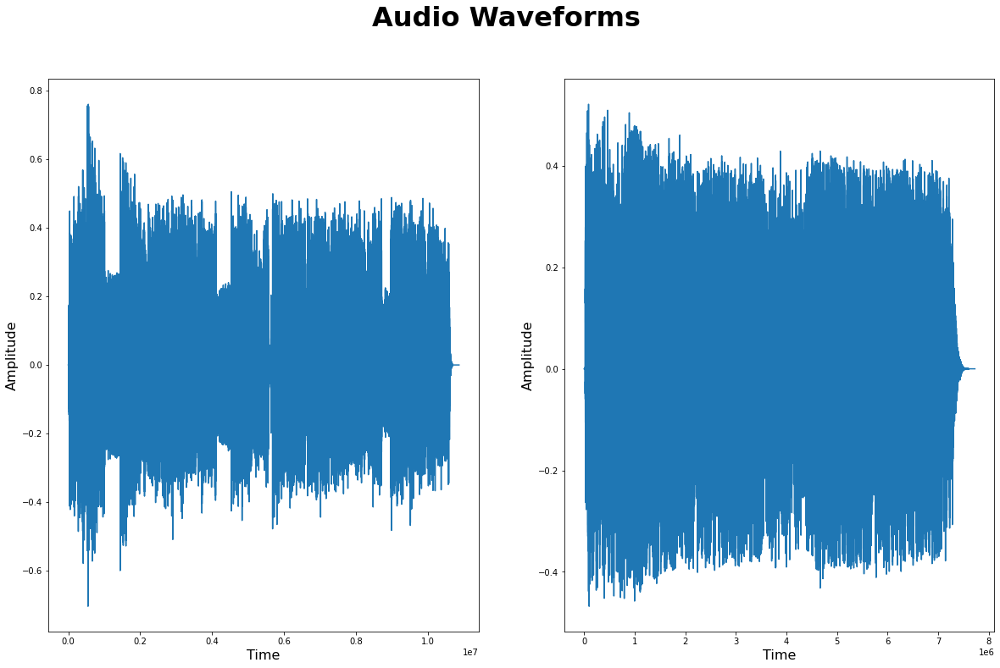

In [12]:
# plotting raw audio waveforms
os.chdir('/home/jesse/dsir-1116/projects/capstone/code')
user_tensor = tf.cast(user_audio_slice, tf.float32)
test_tensor = tf.cast(audio_test_slice, tf.float32) 
fig, ax = plt.subplots(1, 2, figsize = (20, 12))
ax[0].plot(tf.math.maximum(user_tensor.numpy()[:, 0], user_tensor.numpy()[:, 1]))
ax[1].plot(tf.math.maximum(test_tensor.numpy()[:, 0], test_tensor.numpy()[:, 1]))
fig.suptitle('Audio Waveforms', fontweight = 'bold', fontsize = 32)
ax[0].set_xlabel('Time', fontsize = 16)
ax[0].set_ylabel('Amplitude', fontsize = 16)
ax[1].set_xlabel('Time', fontsize = 16)
ax[1].set_ylabel('Amplitude', fontsize = 16)

plt.savefig('../images/raw_audio_signal.png');

In [13]:
# take the maximum signal of each audio channel
user_tensor = tf.math.maximum(user_tensor[:, 0].numpy(), user_tensor[:, 1].numpy())
test_tensor = tf.math.maximum(test_tensor[:, 0].numpy(), test_tensor[:, 1].numpy())

In [14]:
# trimming insignificant noise
user_audio_slice = tfio.experimental.audio.trim(user_tensor, axis = 0, epsilon = 0.1)
test_audio_slice = tfio.experimental.audio.trim(test_tensor, axis = 0, epsilon = 0.1)

In [15]:
user_start = user_audio_slice[0]
user_end = user_audio_slice[1]
test_start = test_audio_slice[0]
test_end = test_audio_slice[1]

In [16]:
user_tensor = user_tensor[user_start:user_end]
test_tensor = test_tensor[test_start:test_end]

In [17]:
# play the audio
Audio(user_tensor, rate=user_audio.rate.numpy())

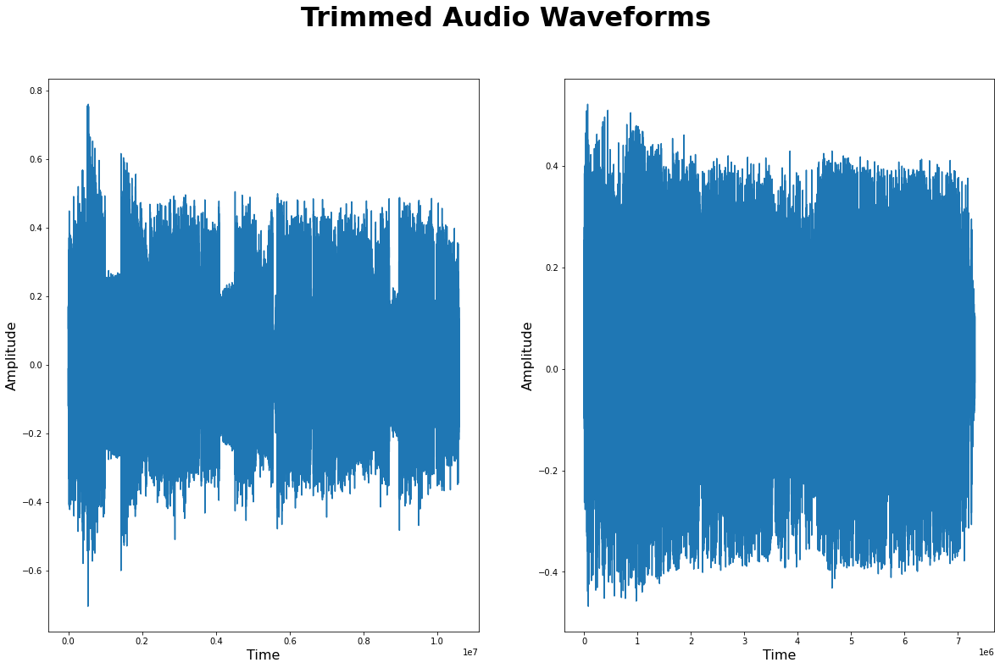

In [18]:
# plotting trimmed audio
fig, ax = plt.subplots(1, 2, figsize = (20, 12))
ax[0].plot(user_tensor)
ax[1].plot(test_tensor)
fig.suptitle('Trimmed Audio Waveforms', fontweight = 'bold', fontsize = 32)
ax[0].set_xlabel('Time', fontsize = 16)
ax[0].set_ylabel('Amplitude', fontsize = 16)
ax[1].set_xlabel('Time', fontsize = 16)
ax[1].set_ylabel('Amplitude', fontsize = 16)

plt.savefig('../images/trimmed_audio_signal.png');

In [19]:
fft_user = tf.signal.fft(tf.cast(user_tensor, dtype = 'complex64'))
fft_user

<tf.Tensor: shape=(10584127,), dtype=complex64, numpy=
array([ 966.8689  -4.88281250e-04j,  117.54111 -1.14245094e+02j,
       -182.42467 -9.00553284e+01j, ...,   25.287397-1.20726692e+02j,
       -182.42458 +9.00553894e+01j,  117.54062 +1.14244774e+02j],
      dtype=complex64)>

In [20]:
stft_user = tf.signal.stft(user_tensor,
                                  frame_length = 1024,
                                  frame_step = 512)
spectrograms_user = tf.abs(stft_user)
stft_test = tf.signal.stft(test_tensor,
                                  frame_length = 1024,
                                  frame_step = 512)
spectrograms_test = tf.abs(stft_test)

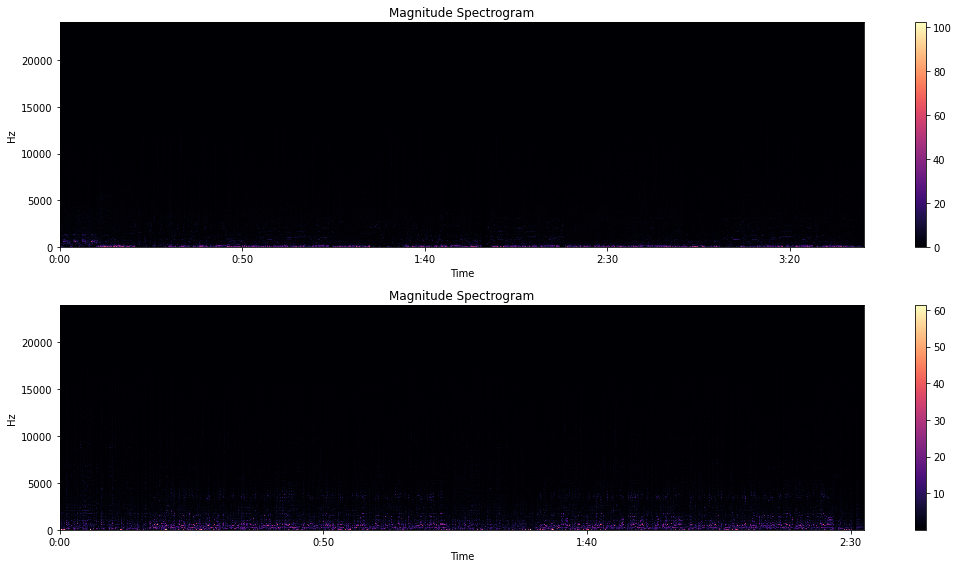

In [22]:
U = spectrograms_user.numpy().T
T = spectrograms_test.numpy().T
plt.figure(figsize = (15, 8))
plt.subplot(2, 1, 1)
lr.display.specshow(U, sr = user_audio.rate.numpy(), y_axis = 'linear', x_axis = 'time')
plt.colorbar()

plt.xlabel('Time')
plt.ylabel('Hz')
plt.title('Magnitude Spectrogram')

plt.subplot(2, 1, 2)
lr.display.specshow(T, sr = audio_test.rate.numpy(), y_axis = 'linear', x_axis = 'time')
plt.colorbar()
plt.xlabel('Time')
plt.ylabel('Hz')
plt.title('Magnitude Spectrogram')
plt.tight_layout()
_ = plt.savefig('../images/magnitude_spectrogram.png');

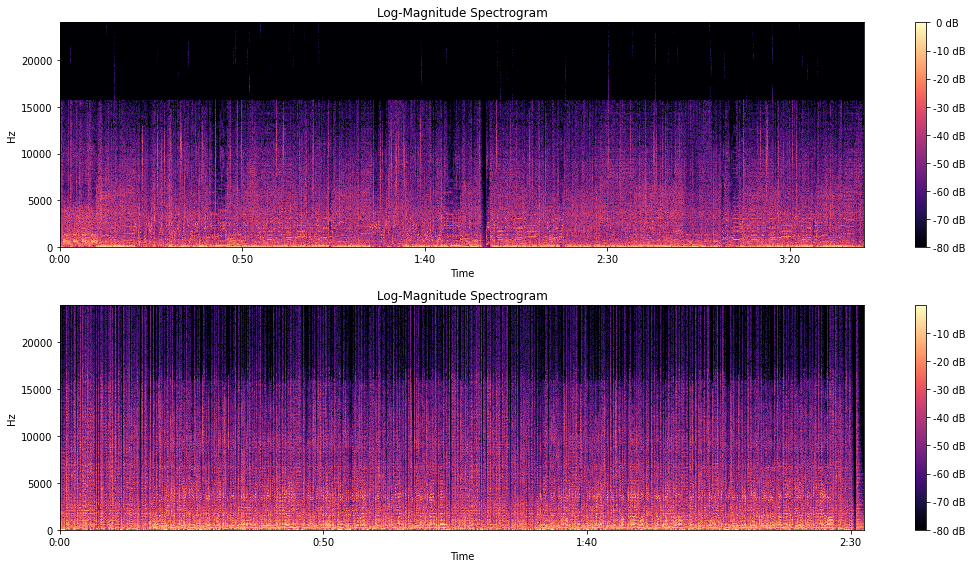

In [23]:
plt.figure(figsize = (15, 8))
plt.subplot(2, 1, 1)
lr.display.specshow(lr.amplitude_to_db(U, ref = np.max), sr = user_audio.rate.numpy(), y_axis = 'linear',
                   x_axis = 'time', hop_length = 512)
plt.colorbar(format = '%2.0f dB')
plt.xlabel('Time')
plt.ylabel('Hz')
plt.title('Log-Magnitude Spectrogram')

plt.subplot(2, 1, 2)
lr.display.specshow(lr.amplitude_to_db(T, ref = np.max), sr = audio_test.rate.numpy(), y_axis = 'linear',
                   x_axis = 'time', hop_length = 512)
plt.colorbar(format = '%+2.0f dB')
plt.xlabel('Time')
plt.ylabel('Hz')
plt.title('Log-Magnitude Spectrogram')
plt.tight_layout()
_ = plt.savefig('../images/log_magnitude_spectrogram.png');

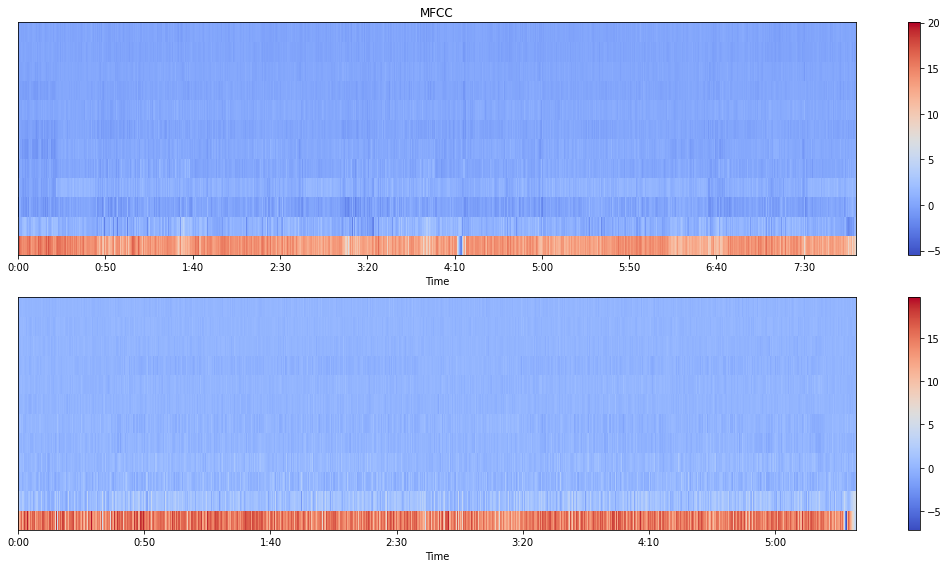

In [24]:
# Warp the linear scale spectrograms into the mel-scale.
user_new_num_spectrogram_bins = stft_user.shape[-1]
lower_edge_hertz, upper_edge_hertz, num_mel_bins = 20.0, 15000.0, 12
user_new_linear_to_mel_weight_matrix = tf.signal.linear_to_mel_weight_matrix(num_mel_bins, 
                                                                            user_new_num_spectrogram_bins, 
                                                                            user_audio.rate.numpy(), 
                                                                            lower_edge_hertz,
                                                                            upper_edge_hertz)
user_new_mel_spectrograms = tf.tensordot(spectrograms_user,
                                        user_new_linear_to_mel_weight_matrix, 
                                        1)
user_new_mel_spectrograms.set_shape(spectrograms_user.shape[:-1].concatenate(user_new_linear_to_mel_weight_matrix.shape[-1:]))

# Compute a stabilized log to get log-magnitude mel-scale spectrograms.
user_new_log_mel_spectrograms = tf.math.log(user_new_mel_spectrograms + 1e-6)

# Compute MFCCs from log_mel_spectrograms and take the first 13.
user_mfccs = tf.signal.mfccs_from_log_mel_spectrograms(user_new_log_mel_spectrograms)

# Warp the linear scale spectrograms into the mel-scale.
test_new_num_spectrogram_bins = stft_test.shape[-1]
lower_edge_hertz, upper_edge_hertz, num_mel_bins = 20.0, 15000.0, 12
test_new_linear_to_mel_weight_matrix = tf.signal.linear_to_mel_weight_matrix(num_mel_bins, 
                                                                            test_new_num_spectrogram_bins, 
                                                                            audio_test.rate.numpy(), 
                                                                            lower_edge_hertz,
                                                                            upper_edge_hertz)
test_new_mel_spectrograms = tf.tensordot(spectrograms_test,
                                        test_new_linear_to_mel_weight_matrix, 
                                        1)
test_new_mel_spectrograms.set_shape(spectrograms_test.shape[:-1].concatenate(test_new_linear_to_mel_weight_matrix.shape[-1:]))

# Compute a stabilized log to get log-magnitude mel-scale spectrograms.
test_new_log_mel_spectrograms = tf.math.log(test_new_mel_spectrograms + 1e-6)

# Compute MFCCs from log_mel_spectrograms and take the first 13.
test_mfccs = tf.signal.mfccs_from_log_mel_spectrograms(test_new_log_mel_spectrograms)

plt.figure(figsize = (15, 8))
plt.subplot(2, 1, 1)
lr.display.specshow(user_mfccs.numpy().T, x_axis = 'time')
plt.colorbar()
plt.xlabel('Time')
plt.title('MFCC')

plt.subplot(2, 1, 2)
lr.display.specshow(test_mfccs.numpy().T, x_axis = 'time')
plt.colorbar()
plt.xlabel('Time')
plt.tight_layout()
_ = plt.savefig('../images/mfcc.png');

In [25]:
# store mfccs of all tracks
def store_tensor(directory):
    mfcc_dict = {}
    # load audio files as Tensors
    for i in tqdm([j for j in os.listdir(directory) if j.endswith('.mp3')]):
        no_space = i.replace(" ", "")
        try:
            new_audio = tfio.audio.AudioIOTensor(os.path.join(directory, i))
            new_audio_tensor = new_audio.to_tensor()
            new_audio_tensor = tf.linalg.normalize(new_audio_tensor)
    
            # trim beginning and end of audio where there is no siginificant noise
            new_audio_trim = tfio.experimental.audio.trim(new_audio_tensor[0], axis = 0, epsilon = 0.0001)
            start_new = new_audio_trim[0][0]
            end_new = new_audio_trim[1][0]
            new_audio_tensor = new_audio[start_new:end_new]
    
            # create spectrogram for song
            try:
                new_stft = tf.signal.stft(tf.math.maximum(new_audio_tensor[:, 0], new_audio_tensor[:, 1]),
                                         frame_length = 2048, 
                                         frame_step = 2048)
            except:
                new_stft = tf.signal.stft(new_audio_tensor[:, 0], 
                                         frame_length = 2048,
                                         frame_step = 2048)
    
            # take absolute value of spectrogram
            new_spectrogram = tf.abs(new_stft)
    
            # Warp the linear scale spectrograms into the mel-scale.
            new_num_spectrogram_bins = new_stft.shape[-1]
            lower_edge_hertz, upper_edge_hertz, num_mel_bins = 20.0, 15000.0, 24
            new_linear_to_mel_weight_matrix = tf.signal.linear_to_mel_weight_matrix(num_mel_bins, 
                                                                                    new_num_spectrogram_bins, 
                                                                                    new_audio.rate.numpy(), 
                                                                                    lower_edge_hertz,
                                                                                    upper_edge_hertz)
            new_mel_spectrograms = tf.tensordot(new_spectrogram,
                                                new_linear_to_mel_weight_matrix, 
                                                1)
            new_mel_spectrograms.set_shape(new_spectrogram.shape[:-1].concatenate(new_linear_to_mel_weight_matrix.shape[-1:]))

            # Compute a stabilized log to get log-magnitude mel-scale spectrograms.
            new_log_mel_spectrograms = tf.math.log(new_mel_spectrograms + 1e-6)

            # Compute MFCCs from log_mel_spectrograms and take the first 13.
            new_mfccs = tf.signal.mfccs_from_log_mel_spectrograms(new_log_mel_spectrograms)
            mfcc_dict[no_space] = new_mfccs
        except:
            pass
    return mfcc_dict

In [27]:
new_directory = '/media/jesse/Number2/tracks/'
new_mfcc_dict = store_tensor(new_directory) 

100%|██████████| 4806/4806 [51:13<00:00,  1.56it/s]   


In [28]:
user_directory = '/media/jesse/Number4/user_tracks/'
user_mfcc_dict = store_tensor(user_directory)

100%|██████████| 41/41 [00:26<00:00,  1.53it/s]


In [29]:
# save dictionaries
with open('user_dict.p', 'wb') as fp:
    pickle.dump(user_mfcc_dict, fp, protocol = pickle.HIGHEST_PROTOCOL)

with open('new_dict.p', 'wb') as fp:
    pickle.dump(new_mfcc_dict, fp, protocol = pickle.HIGHEST_PROTOCOL)

In [30]:
# load dictionaries
with open('user_dict.p', 'rb') as user_fp:
    user_mfcc_dict = pickle.load(user_fp)
with open('new_dict.p', 'rb') as new_fp:
    new_mfcc_dict = pickle.load(new_fp)

In [32]:
def compare_audio(user, new_release):
    # load audio files as Tensors
    user_audio = tfio.audio.AudioIOTensor(user)
    user_audio_tensor = user_audio.to_tensor()
    user_audio_tensor = tf.linalg.normalize(user_audio_tensor)
    new_audio = tfio.audio.AudioIOTensor(new_release)
    new_audio_tensor = new_audio.to_tensor()
    new_audio_tensor = tf.linalg.normalize(new_audio_tensor)
    
    # trim beginning and end of audio where there is no siginificant noise
    user_audio_trim = tfio.experimental.audio.trim(user_audio_tensor[0], axis = 0, epsilon = 0.0001)
    new_audio_trim = tfio.experimental.audio.trim(new_audio_tensor[0], axis = 0, epsilon = 0.0001)
    start_user = user_audio_trim[0][0]
    end_user = user_audio_trim[1][0]
    start_new = new_audio_trim[0][0]
    end_new = new_audio_trim[1][0]
    user_audio_tensor = user_audio[start_user:end_user]
    new_audio_tensor = new_audio[start_new:end_new]
    
    # check size of both songs and change them to be the same
    if user_audio_tensor.shape[0] > new_audio_tensor.shape[0]:
        user_start = (user_audio_tensor.shape[0]//2) - (new_audio_tensor.shape[0]//2)
        user_end = (user_audio_tensor.shape[0]//2) + (int(np.ceil(new_audio_tensor.shape[0]/2)))
        user_audio_tensor = user_audio[user_start:user_end]
    elif user_audio_tensor.shape[0] < new_audio_tensor.shape[0]:
        new_start = (new_audio_tensor.shape[0]//2) - (user_audio_tensor.shape[0]//2)
        new_end = (new_audio_tensor.shape[0]//2) + (int(np.ceil(user_audio_tensor.shape[0]/2)))
        new_audio_tensor = new_audio[new_start:new_end]
    
    # create spectrograms for each song
    user_spectrogram = tf.signal.stft(tf.math.maximum(user_audio_tensor[:, 0], user_audio_tensor[:, 1]),
                                     frame_length = 2048,
                                     frame_step = 2048) 
    new_spectrogram = tf.signal.stft(tf.math.maximum(new_audio_tensor[:, 0], new_audio_tensor[:, 1]), 
                                     frame_length = 2048,  
                                     frame_step = 2048)
    
    # take absolute value of spectrograms
    user_spectrogram = tf.abs(user_spectrogram)
    new_spectrogram = tf.abs(new_spectrogram)
    
    # calculate and return cosine similarity
    cosine_loss = tf.keras.losses.CosineSimilarity(axis = -1)
    score = cosine_loss(user_spectrogram, new_spectrogram).numpy()
    return score

In [33]:
# test tensorflow cosine similarity with one song
score_list = []
score_dict = {}
user_directory = '/media/jesse/Number4/user_tracks'
new_directory = '/media/jesse/Number2/tracks'
for i in tqdm(os.listdir(new_directory)):
    #for j in os.listdir(new_directory):
    try:
        if i.endswith('.mp3'): #and j.endswith('.mp3')
            score = compare_audio(os.path.join(new_directory, i), '/media/jesse/Number4/user_tracks/(K)NoW_NAME - KNOCK on the CORE.mp3')
            score_dict[i] = score
        score_list.append(score_dict)
    except: 
        pass

100%|██████████| 7989/7989 [1:39:11<00:00,  1.34it/s]


In [34]:
score_list = [score_dict]
score_list

[{'2 Shadows - Screamworks.mp3': -0.782927,
  'DreamDoll - Different - Freestyle Clean.mp3': -0.62271106,
  'SUNDAYS - Drifter.mp3': -0.6734982,
  'Los Pascual - La Mujer Mas Bella.mp3': -0.66896605,
  'Bad Waitress - Pre Post-Period Blues.mp3': -0.6448755,
  'The Woodlands - Trouble in Your Heart.mp3': -0.6450562,
  'Bolshevseh - Луче.mp3': -0.6817631,
  'Iacho, G Sony - Beatbox Session 5.mp3': -0.6703246,
  'Gavin Santi - Here Freestyle.mp3': -0.6513436,
  'Zion I, Nathan Fields, Born I - 2 Eyes.mp3': -0.6226858,
  'Ehrling - Hurt Me (feat. WILHELM).mp3': -0.65264285,
  'Dennis Arana - Me Cansé.mp3': -0.63317364,
  "Rigeo, Franco 'El Gorilla' - Cardi o Nicki.mp3": -0.62309873,
  'McEndoz - Slip Away - Piano solo.mp3': -0.6720352,
  'Arman Ferrer - OK LANG BA.mp3': -0.66944563,
  '糖兄妹 - 愛我還是他 (音樂永續作品).mp3': -0.57902944,
  'Jae Kidd - Gentleman.mp3': -0.64227957,
  'MELODOWNZ - Money.mp3': -0.6463686,
  'Guy Verlinde - The Way You Are.mp3': -0.6235431,
  'Rin - Close.mp3': -0.6165335,


In [35]:
score_df = pd.DataFrame(score_list)
score_df

,2 Shadows - Screamworks.mp3,DreamDoll - Different - Freestyle Clean.mp3,SUNDAYS - Drifter.mp3,Los Pascual - La Mujer Mas Bella.mp3,Bad Waitress - Pre Post-Period Blues.mp3,The Woodlands - Trouble in Your Heart.mp3,Bolshevseh - Луче.mp3,"Iacho, G Sony - Beatbox Session 5.mp3",Gavin Santi - Here Freestyle.mp3,"Zion I, Nathan Fields, Born I - 2 Eyes.mp3",...,Lil Coffin - hungover.mp3,Dario Nunez - Candelaria - Original mix.mp3,"Apashe, Yizzy - Dead - Marten Hørger Remix.mp3",Vitor Kley - Anjo ou Mulher (Acústico).mp3,Brunno Ramos - Controle.mp3,Чингиз Валинуров - Не угасай.mp3,GameboyJones - Big Bang (Bakugo).mp3,Lahos - Bright Eyes.mp3,Yvar - Dynamite.mp3,Loser - 333.mp3
0,-0.782927,-0.622711,-0.673498,-0.668966,-0.644876,-0.645056,-0.681763,-0.670325,-0.651344,-0.622686,...,-0.623904,-0.670982,-0.655986,-0.624839,-0.644082,-0.679907,-0.614841,-0.624098,-0.62313,-0.613509


In [37]:
%%time
# testing fastdtw
distance, path = fastdtw(new_mfcc_dict['2Shadows-Screamworks.mp3'], user_mfcc_dict['MYFIRSTSTORY-REVIVER.mp3'], dist = euclidean)
print(distance)

22417.028118033522
CPU times: user 1.56 s, sys: 12.2 ms, total: 1.57 s
Wall time: 1.57 s


In [39]:
%%time
# testing linmdtw
path = linmdtw(new_mfcc_dict['2Shadows-Screamworks.mp3'].numpy(), user_mfcc_dict['MYFIRSTSTORY-REVIVER.mp3'].numpy())
print(path[-1, -1])

7495
CPU times: user 4.13 s, sys: 893 ms, total: 5.03 s
Wall time: 4.96 s


In [41]:
%%time
# testing dtwgpu
dtwgpu.dtw_diag_gpu(new_mfcc_dict['2Shadows-Screamworks.mp3'].numpy(), user_mfcc_dict['MYFIRSTSTORY-REVIVER.mp3'].numpy())

CPU times: user 1.06 s, sys: 11.6 ms, total: 1.07 s
Wall time: 1.07 s


{'cost': 22056.39}

In [42]:
def is_empty(any_structure):
    if any_structure:
        return False
    else:
        print('Structure is empty.')
        return True

In [31]:
def create_score(user_mfcc, new_mfcc):
    all_scores = []
    for i in user_mfcc:
        score = []
        for j in tqdm(new_mfcc):
            try:
                path = dtwgpu.dtw_diag_gpu(i, j)
                score.append(path['cost'])
            except:
                pass
        all_scores.append(score)
    return all_scores
all_scores = create_score([i for i in user_mfcc_dict.values()], [i for i in new_mfcc_dict.values()])
# pool = Pool(1)
# all_scores = pool.starmap(create_score, [([i for i in user_mfcc_dict.values()], [i for i in new_mfcc_dict.values()])])
# all_scores

100%|██████████| 4806/4806 [1:14:46<00:00,  1.07it/s]


In [51]:
all_scores = np.array(all_scores)
all_scores.shape

(41, 4805)

In [20]:
# # using Numba CUDA
# @vectorize(['float32(float32[:, :], float32[:, :])'], target = 'cuda')
# def dtw_dist(new_mfcc_values, user_mfcc_values):
#     l1 = new_mfcc_values.shape[0]
#     l2 = user_mfcc_values.shape[0]
#     E = cuda.device_array((l1, l2), dtype = np.float)
#     E[0][0] = np.square(new_mfcc_values[0] - user_mfcc_values[0])
#     for i in range(1, l1):
#         E[i][0] = E[i - 1][0] + np.square(new_mfcc_values[i] - user_mfcc_values[0])
#     for i in range(1, l2):
#         E[0][i] = E[0][i-1] + np.square(new_mfcc_values[0] - user_mfcc_values[i])
#     for i in range(1, l1):
#         for j in range(1, l2):
#             v = np.square(new_mfcc_values[i] - user_mfcc_values[j])
            
#             v1 = E[i - 1][j]
#             v2 = E[i - 1][j - 1]
#             v3 = E[i][j - 1]
            
#             if v1 <= v2 and v1 <= v3:
#                 E[i][j] = v1 + v
#             elif v2 <= v1 and v2 <= v3:
#                 E[i][j] = v2 + v
#             else:
#                 E[i][j] = v3 + v
#     return np.sqrt(E[-1][-1])

# dtw_dist(new_mfcc_dict['2Shadows-Screamworks'], user_mfcc_dict['MYFIRSTSTORY-REVIVER'])
# # @cuda.jit
# # def dtw_kernel(new_mfcc_list, user_mfcc_list):
# #     rows = user_mfcc_list.shape[0]
# #     cols = new_mfcc_list.shape[0]
# #     scores = np.zeros((rows, cols))
# #     for i in user_mfcc_list:
# #         for j in new_mfcc_list:
# #             scores[i, j] = dtw_dist(i, j)

# # new_mfcc_list = cuda.to_device(np.array(list(new_mfcc_dict.values())))
# # user_mfcc_list = cuda.to_device(np.array(list(user_mfcc_dict.values())))
# # dtw_kernel[512, 32](new_mfcc_list, user_mfcc_list)

TypingError: Failed in nopython mode pipeline (step: nopython frontend)
[1m[1mUnknown attribute 'device_array' of type Module(<module 'numba.cuda' from '/home/jesse/anaconda3/envs/dsi_venv/lib/python3.8/site-packages/numba/cuda/__init__.py'>)
[1m
File "<ipython-input-20-323782c9853f>", line 6:[0m
[1mdef dtw_dist(new_mfcc_values, user_mfcc_values):
    <source elided>
    l2 = user_mfcc_values.shape[0]
[1m    E = cuda.device_array((l1, l2), dtype = np.float)
[0m    [1m^[0m[0m
[0m
[0m[1mDuring: typing of get attribute at <ipython-input-20-323782c9853f> (6)[0m
[1m
File "<ipython-input-20-323782c9853f>", line 6:[0m
[1mdef dtw_dist(new_mfcc_values, user_mfcc_values):
    <source elided>
    l2 = user_mfcc_values.shape[0]
[1m    E = cuda.device_array((l1, l2), dtype = np.float)
[0m    [1m^[0m[0m


The above was an attempt to increase parallelization on the GPU, however numba and CUDA and very difficult to work with, so it got shelved. 